## Lab 1. Camera calibration
**Ignashov V.M. 9303**

In [1]:
import os.path

import numpy as np
import cv2
import glob
from PIL import Image
from IPython.display import display

### Defining variables and collecting images

In [2]:
CELLS_IN_ROW, CELLS_IN_COLUMN = 15, 11
NUMBER_POINTS_ROW, NUMBER_POINTS_COLUMN = CELLS_IN_ROW - 1, CELLS_IN_COLUMN - 1

# Termination criteria: stop the algorithm iteration if specified number of iterations or accuracy is reached.
# Number of iterations and accuracy to stop specified as second and third parameters
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# Prepare 3D object points (x,y,z), like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
object_points = np.zeros((NUMBER_POINTS_ROW * NUMBER_POINTS_COLUMN, 3), np.float32)
object_points[:, :2] = np.mgrid[0:NUMBER_POINTS_ROW, 0:NUMBER_POINTS_COLUMN].T.reshape(-1, 2)

# Arrays to store object points and image points from all the images.
points_3D = []  # 3D points in real world space
points_2D = []  # 2D points in image plane.

# Images to calibrate
images = glob.glob('data/calibrate/*.jpg')
default_image = images[0]

#### Example of an image:

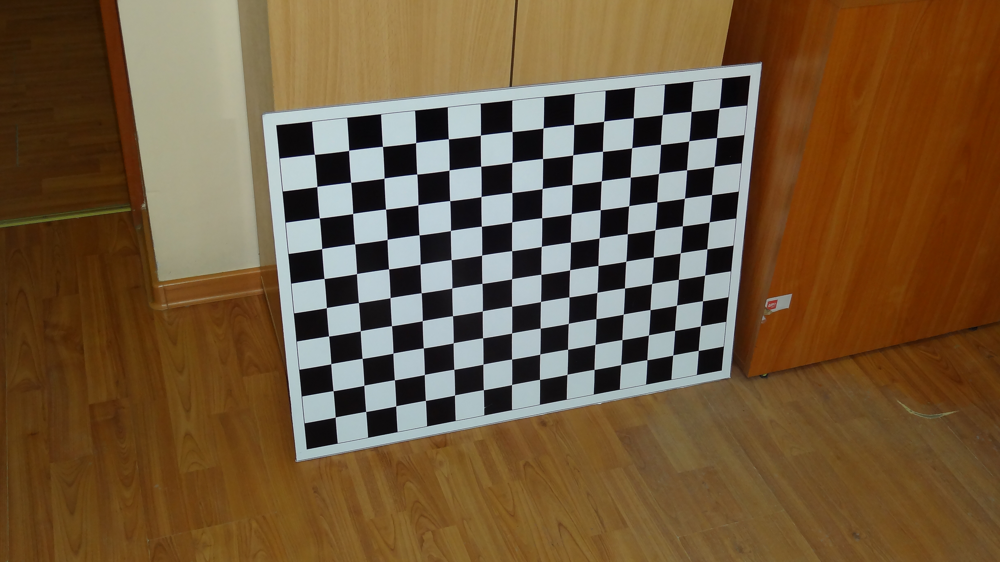

In [3]:
display(Image.open(f'data/calibrate/{os.path.basename(images[0])}'))

### Points detection

In [4]:
for frame_name in images:
    img = cv2.imread(frame_name)  # Read the image
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convert the image to grayscale

    # Find the chess board corners on grayscale image
    chessboard_found, corners = cv2.findChessboardCorners(gray_img, (NUMBER_POINTS_ROW, NUMBER_POINTS_COLUMN))

    # If chessboard found, add object points, image points (after refining them)
    if chessboard_found:
        points_3D.append(object_points)

        corners2 = cv2.cornerSubPix(gray_img, corners, (11, 11), (-1, -1), criteria)  # refining img pts
        points_2D.append(corners2)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (NUMBER_POINTS_ROW, NUMBER_POINTS_COLUMN), corners2, chessboard_found)

        # Show, write to file, whatever
        # cv2.imshow('img', img)
        cv2.imwrite(f'data/results/with_patterns/{os.path.basename(frame_name)}', img)
        cv2.waitKey(500)

#### Image with pattern

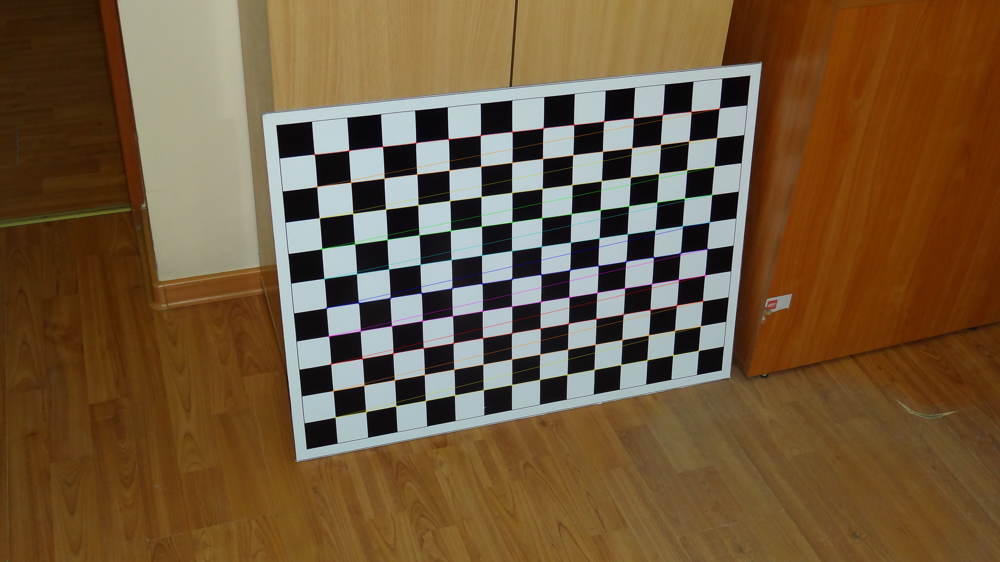

In [5]:
display(Image.open(f'data/results/with_patterns/{os.path.basename(images[0])}'))

### Camera calibration

In [6]:
(
    _, camera_matrix,
    distortion_coefficient,
    rotation_vectors,
    translation_vectors
) = cv2.calibrateCamera(points_3D, points_2D, gray_img.shape[::-1], None, None)

# Save camera matrix and distortion coefficients to txts
np.savetxt(f'data/results/camera_matrix.txt', camera_matrix)
np.savetxt(f'data/results/distortion_coefficient.txt', distortion_coefficient)

#### Intrinsic parameters:

In [7]:
camera_matrix

array([[6.05304389e+03, 0.00000000e+00, 2.54106629e+03],
       [0.00000000e+00, 6.03790774e+03, 1.30293219e+03],
       [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]])

In [8]:
distortion_coefficient

array([[-1.75617465e-01,  3.62500847e+00,  3.27014371e-03,
         3.28190306e-03, -2.11790231e+01]])

#### Extrinsic parameters:

In [9]:
rotation_vectors

(array([[ 0.45590315],
        [-0.33471187],
        [-0.07278109]]),
 array([[ 0.45060018],
        [-0.2504773 ],
        [-0.0211829 ]]),
 array([[ 0.45231412],
        [-0.08096209],
        [ 0.01110823]]),
 array([[0.40956278],
        [0.09488637],
        [0.02728659]]),
 array([[0.42292285],
        [0.09803041],
        [0.01790061]]),
 array([[0.41234971],
        [0.22872319],
        [0.07403409]]),
 array([[0.38685735],
        [0.23959846],
        [0.06260513]]),
 array([[0.38663206],
        [0.33821259],
        [0.10402405]]),
 array([[0.37301525],
        [0.28350842],
        [0.08806543]]),
 array([[ 0.50062551],
        [-0.55050942],
        [-0.14502687]]),
 array([[ 0.46112461],
        [-0.26717257],
        [-0.03654973]]),
 array([[ 0.36117959],
        [-0.02702409],
        [ 0.00261545]]),
 array([[0.34703617],
        [0.10764401],
        [0.01437143]]),
 array([[ 0.38796804],
        [-0.23055674],
        [-0.05054311]]),
 array([[0.36616817],
     

In [10]:
translation_vectors

(array([[-5.86132575],
        [-3.2064895 ],
        [35.54370616]]),
 array([[-6.23182688],
        [-2.56579211],
        [35.19734932]]),
 array([[-5.784404  ],
        [-3.18894759],
        [36.38687153]]),
 array([[-6.24668355],
        [-3.37393157],
        [40.07647868]]),
 array([[-8.20364183],
        [-3.45929401],
        [40.39845795]]),
 array([[-7.2050625 ],
        [-3.92384515],
        [41.06436981]]),
 array([[-8.04161277],
        [-3.12570449],
        [41.79096552]]),
 array([[-7.42250526],
        [-4.17015816],
        [43.50172883]]),
 array([[-7.29217727],
        [-4.03971215],
        [44.44767923]]),
 array([[-5.47911851],
        [-1.33780254],
        [31.0978186 ]]),
 array([[-5.65592428],
        [-2.76564247],
        [34.44428315]]),
 array([[-6.42023586],
        [-1.90397761],
        [41.71735712]]),
 array([[-6.92089952],
        [-2.18236447],
        [43.85854911]]),
 array([[-7.05164395],
        [-2.99818414],
        [34.77950146]]),
 array

### Camera refining

In [11]:
undistort_img = cv2.imread(images[0]) # take one of the images
height, width = undistort_img.shape[:2]

new_camera_matrix, roi = cv2.getOptimalNewCameraMatrix(
    camera_matrix, distortion_coefficient, (width, height), 1, (width, height)
)  # alpha==1, so pixels are retained with extra black images
x, y, width, height = roi

### Image undistortion

In [12]:
undistorted_image = cv2.undistort(
    undistort_img, camera_matrix, distortion_coefficient, None, new_camera_matrix
)[y:y + height, x:x + width]  # Crop the image

cv2.imwrite(f'data/results/undistorted/{os.path.basename(images[0])}', undistorted_image)

True

#### Undistorted image:

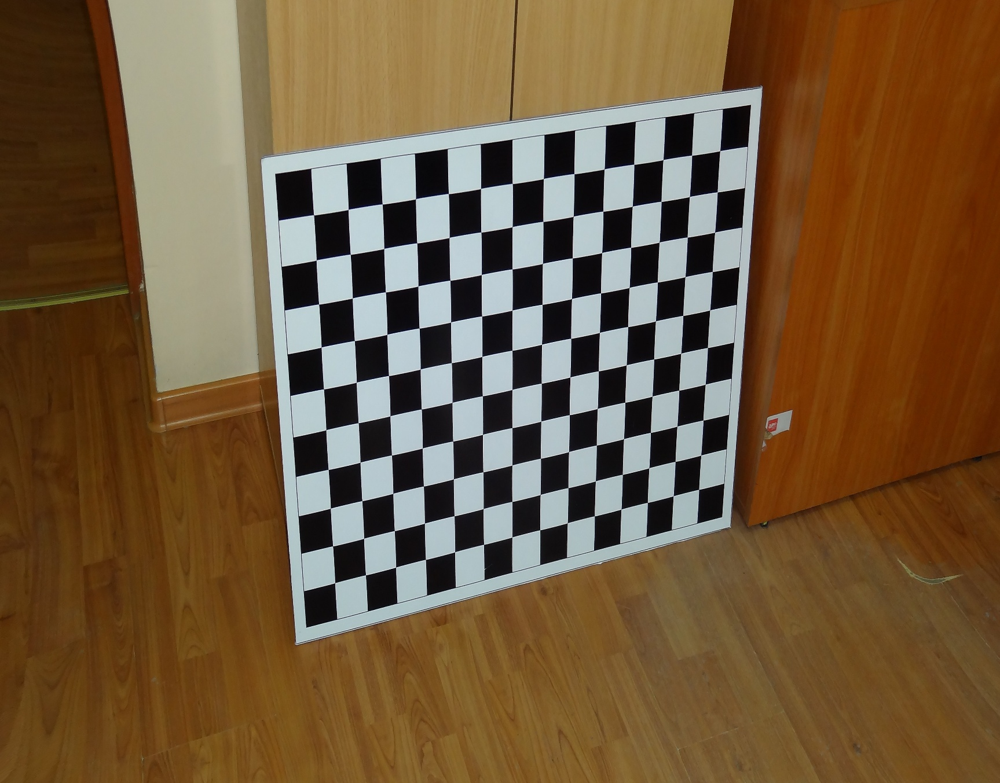

In [13]:
display(Image.open(f'data/results/undistorted/{os.path.basename(images[0])}'))

### Calculating re-projection error

In [14]:
mean_error = 0
for i in range(len(points_3D)):
    points_2D_2, _ = cv2.projectPoints(points_3D[i], rotation_vectors[i], translation_vectors[i], camera_matrix,
                                       distortion_coefficient)
    error = cv2.norm(points_2D[i], points_2D_2, cv2.NORM_L2) / len(points_2D_2)
    mean_error += error

mean_error / len(points_3D)

0.1550997067861835